# Installations

In [1]:
!pip install imagehash
import imagehash

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 26.8 MB/s eta 0:00:00


In [2]:
import os
import numpy as np
import pandas as pd
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
from tqdm import tqdm

if tf.test.gpu_device_name():
    print('GPU found:', tf.test.gpu_device_name())
else:
    print('No GPU found. Please select a GPU runtime.')

GPU found: /device:GPU:0


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
csv_path = "/content/drive/MyDrive/CSM 2025/data/data-full.csv"
df = pd.read_csv(csv_path, parse_dates=['date_posted'])
df['incident_id'] = df['incident_id'].astype(str)

# pHash approach

Perceptual hashing (pHash) generates a compact fingerprint of an image based on its visual content. Even if an image is slightly modified—through resizing, compression, or small edits—the pHash remains largely unchanged, making it effective for identifying near-duplicates.

This method is computationally efficient, making it ideal for large datasets when you expect images to be nearly identical in appearance.

In [5]:
images_dir = "/content/drive/MyDrive/CSM 2025/images"
hash_to_files = {}

for filename in tqdm(os.listdir(images_dir), desc="Processing images with pHash"):
    file_path = os.path.join(images_dir, filename)
    if os.path.isfile(file_path):
        try:
            with Image.open(file_path) as img:
                phash = imagehash.phash(img)
            # Convert hash to string so it can be used as a dict key
            hash_to_files.setdefault(str(phash), []).append(filename)
        except Exception as e:
            print(f"Error processing {filename}: {e}")

# Filter to groups with duplicates
duplicate_groups = {h: files for h, files in hash_to_files.items() if len(files) > 1}

# Determine the original image for each group using tqdm
results = []
for file_hash, files in tqdm(duplicate_groups.items(), desc="Determining originals (pHash)"):
    group_info = []
    for fname in files:
        # Extract the incident id from file name (assuming format "incident_id.ext")
        incident = os.path.splitext(fname)[0]
        # Look up the date_posted for this incident in the CSV
        row = df.loc[df['incident_id'] == incident]
        if not row.empty:
            # If there are multiple rows, pick the earliest date
            date_posted = row['date_posted'].min()
        else:
            # If no matching CSV entry, use a high placeholder date
            date_posted = pd.Timestamp.max
        group_info.append((fname, incident, date_posted))

    # Sort by date_posted so the earliest becomes the "original"
    group_info_sorted = sorted(group_info, key=lambda x: x[2])
    original = group_info_sorted[0]  # (filename, incident, date)
    duplicates = group_info_sorted[1:]  # Remaining items

    results.append({
        'original_file': original[0],
        'original_incident': original[1],
        'duplicate_count': len(duplicates),
        'duplicate_incidents': [dup[1] for dup in duplicates],
        'group_files': files
    })

Determining originals (pHash): 100%|██████████| 104/104 [00:00<00:00, 685.05it/s]


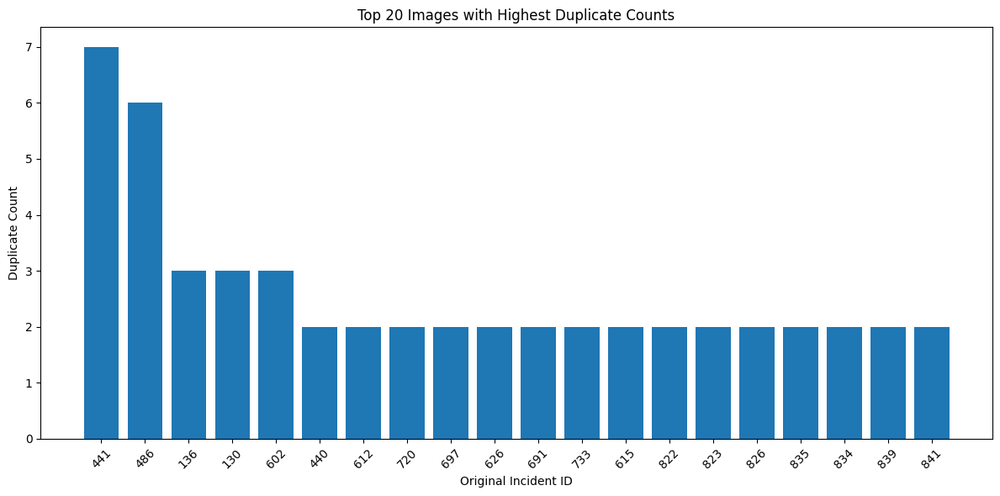

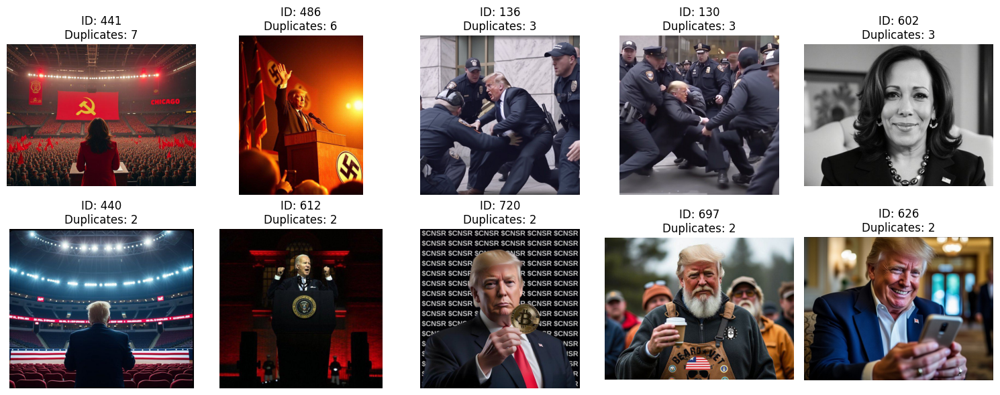

In [6]:
results_sorted = sorted(results, key=lambda group: group['duplicate_count'], reverse=True)

# Histogram of top 20 groups
top_20 = results_sorted[:20]
incident_ids = [group['original_incident'] for group in top_20]
duplicate_counts = [group['duplicate_count'] for group in top_20]

plt.figure(figsize=(12, 6))
plt.bar(incident_ids, duplicate_counts)
plt.xlabel('Original Incident ID')
plt.ylabel('Duplicate Count')
plt.title('Top 20 Images with Highest Duplicate Counts')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# View top 10 groups
top_10 = results_sorted[:10]

fig, axs = plt.subplots(2, 5, figsize=(15, 6))
axs = axs.flatten()

for i, group in enumerate(top_10):
    file_path = os.path.join(images_dir, group['original_file'])
    try:
        img = Image.open(file_path)
        axs[i].imshow(img)
        axs[i].set_title(f"ID: {group['original_incident']}\nDuplicates: {group['duplicate_count']}")
        axs[i].axis('off')
    except Exception as e:
        axs[i].text(0.5, 0.5, f"Error\n{group['original_file']}",
                    horizontalalignment='center', verticalalignment='center')
        axs[i].axis('off')

plt.tight_layout()
plt.show()

In [7]:
total_images = len(os.listdir(images_dir))
total_duplicate_images = sum(r['duplicate_count'] for r in results)

# The remaining original images include the chosen original in each duplicate group + images with no duplicates.
remaining_originals = total_images - total_duplicate_images

print("Total images in folder:", total_images)
print("Total duplicate images (to remove):", total_duplicate_images)
print("Total original images remaining:", remaining_originals)

Total images in folder: 641
Total duplicate images (to remove): 143
Total original images remaining: 498


# Deep Learning Embedding Approach

The embedding approach uses deep neural networks (like ResNet50) to extract high-dimensional feature vectors (embeddings) that capture complex visual characteristics of images. By comparing these embeddings using measures like cosine similarity, this method can detect duplicates even when images undergo significant transformations.

Although more robust than pHash, this technique is computationally more intensive and often benefits from GPU acceleration, especially on larger datasets.

Here we set the similarity threshold to be 93%, in order to capture small variants of the same image.

In [8]:
# Load ResNet50 Model for Embeddings
base_model = ResNet50(weights='imagenet', include_top=True)
model = Model(inputs=base_model.input, outputs=base_model.get_layer('avg_pool').output)

images_dir = "/content/drive/MyDrive/CSM 2025/images"
filenames = []
img_list = []

for filename in tqdm(os.listdir(images_dir), desc="Processing images for embeddings"):
    file_path = os.path.join(images_dir, filename)
    try:
        img = image.load_img(file_path, target_size=(224, 224))
        x = image.img_to_array(img)
        img_list.append(x)
        filenames.append(filename)
    except Exception as e:
        print(f"Error processing {filename}: {e}")

if not img_list:
    raise ValueError("No images loaded. Please check your images directory.")

img_array = np.array(img_list)
img_array = preprocess_input(img_array)

print("Computing embeddings...")
embeddings = model.predict(img_array, batch_size=32)

print("Computing cosine similarity matrix...")
cos_sim = cosine_similarity(embeddings)
similarity_threshold = 0.93

# Gather duplicate pairs from the upper triangle
n = len(filenames)
duplicate_pairs = []
upper_tri_indices = np.triu_indices(n, k=1)
for idx in tqdm(range(len(upper_tri_indices[0])), desc="Computing duplicate pairs"):
    i = upper_tri_indices[0][idx]
    j = upper_tri_indices[1][idx]
    if cos_sim[i, j] > similarity_threshold:
        duplicate_pairs.append((i, j))
print(f"Found {len(duplicate_pairs)} duplicate pairs.")

# Group duplicates using union-find
parent = list(range(n))
def find(i):
    if parent[i] != i:
        parent[i] = find(parent[i])
    return parent[i]
def union(i, j):
    ri = find(i)
    rj = find(j)
    if ri != rj:
        parent[rj] = ri

for i, j in tqdm(duplicate_pairs, desc="Grouping duplicate pairs"):
    union(i, j)

groups = {}
for i in tqdm(range(n), desc="Building groups"):
    root = find(i)
    groups.setdefault(root, []).append(i)
duplicate_groups = [group for group in groups.values() if len(group) > 1]
print(f"Found {len(duplicate_groups)} groups with duplicates.")

# Determine the original image in each group
results = []
for group in tqdm(duplicate_groups, desc="Determining originals (embeddings)"):
    group_info = []
    for idx in group:
        fname = filenames[idx]
        # Extract incident id (assumes filename like "incidentID.ext")
        incident = os.path.splitext(fname)[0]
        # Look up date_posted from CSV (assign max date if not found)
        row = df.loc[df['incident_id'] == incident]
        if not row.empty:
            date_posted = row['date_posted'].min()
        else:
            date_posted = pd.Timestamp.max
        group_info.append((fname, incident, date_posted))

    # Determine original image: the one with the earliest date_posted
    group_info_sorted = sorted(group_info, key=lambda x: x[2])
    original = group_info_sorted[0]  # (filename, incident, date)
    duplicates = group_info_sorted[1:]
    results.append({
        'original_file': original[0],
        'original_incident': original[1],
        'duplicate_count': len(duplicates),
        'duplicate_incidents': [dup[1] for dup in duplicates],
        'group_files': [info[0] for info in group_info_sorted]
    })

102967424/102967424 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Processing images for embeddings: 100%|██████████| 641/641 [00:15<00:00, 41.40it/s]


Computing embeddings...
21/21 ━━━━━━━━━━━━━━━━━━━━ 13s 313ms/step
Computing cosine similarity matrix...


Computing duplicate pairs: 100%|██████████| 205120/205120 [00:00<00:00, 929609.18it/s]


Found 428 duplicate pairs.


Building groups: 100%|██████████| 641/641 [00:00<00:00, 647375.12it/s]


Found 163 groups with duplicates.


Determining originals (embeddings): 100%|██████████| 163/163 [00:00<00:00, 641.02it/s]


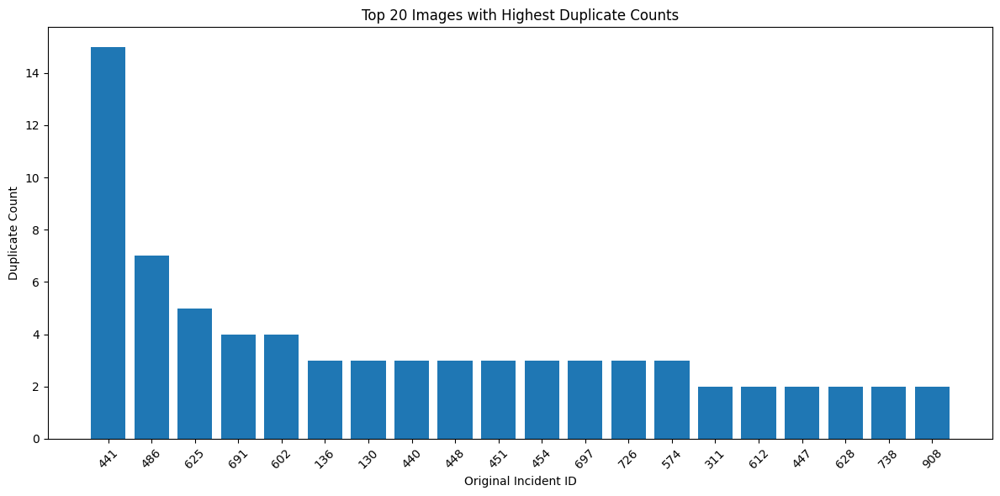

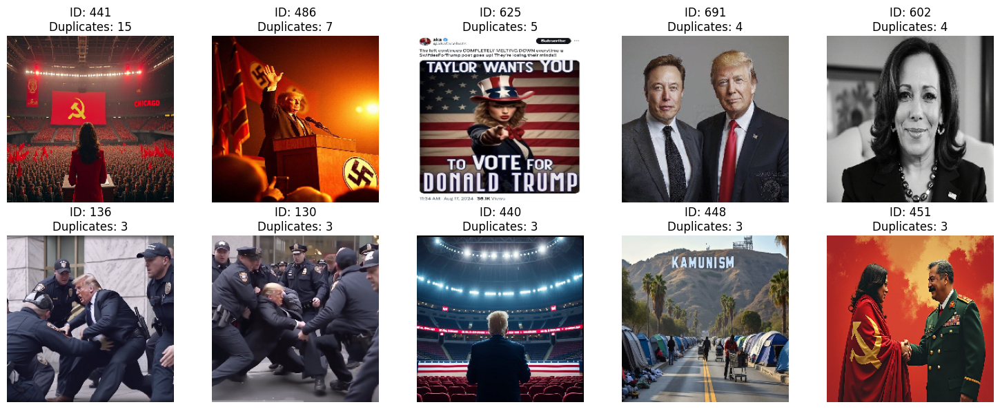

In [9]:
# Histogram of top 20 images with highest duplicate counts
if results:
    results_sorted = sorted(results, key=lambda x: x['duplicate_count'], reverse=True)
    top_20 = results_sorted[:20]
    incident_ids = [r['original_incident'] for r in top_20]
    duplicate_counts = [r['duplicate_count'] for r in top_20]

    plt.figure(figsize=(12, 6))
    plt.bar(incident_ids, duplicate_counts)
    plt.xlabel('Original Incident ID')
    plt.ylabel('Duplicate Count')
    plt.title('Top 20 Images with Highest Duplicate Counts')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    # Subplot Grid for Top 10 Images
    top_10 = results_sorted[:10]
    fig, axs = plt.subplots(2, 5, figsize=(15, 6))
    axs = axs.flatten()
    for i, r in enumerate(top_10):
        file_path = os.path.join(images_dir, r['original_file'])
        try:
            img = image.load_img(file_path, target_size=(224, 224))
            axs[i].imshow(img)
            title_str = f"ID: {r['original_incident']}\nDuplicates: {r['duplicate_count']}"
            axs[i].set_title(title_str)
            axs[i].axis('off')
        except Exception as e:
            axs[i].text(0.5, 0.5, f"Error loading image",
                        horizontalalignment='center', verticalalignment='center')
            axs[i].axis('off')
    plt.tight_layout()
    plt.show()
else:
    print("No duplicate groups found for visualization.")

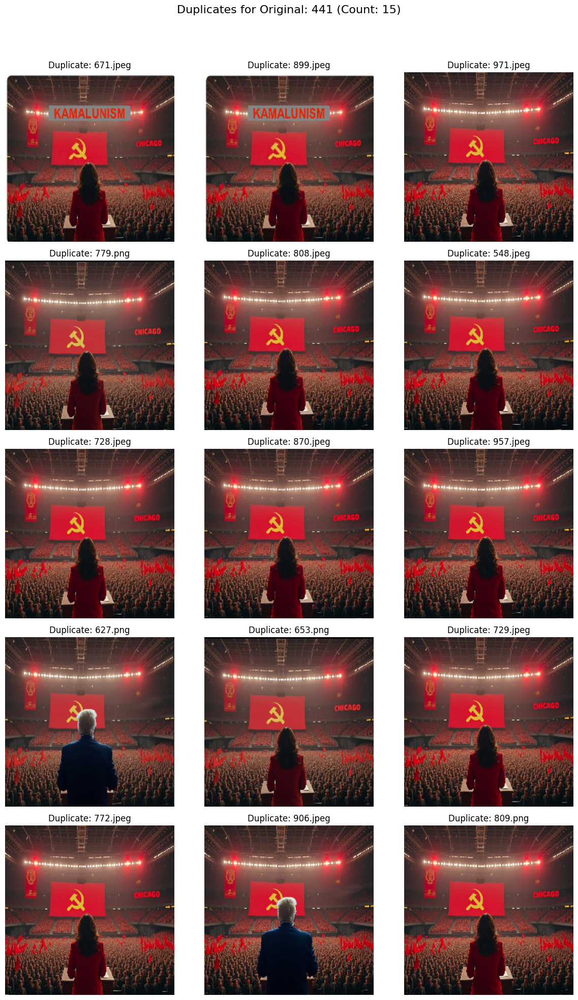

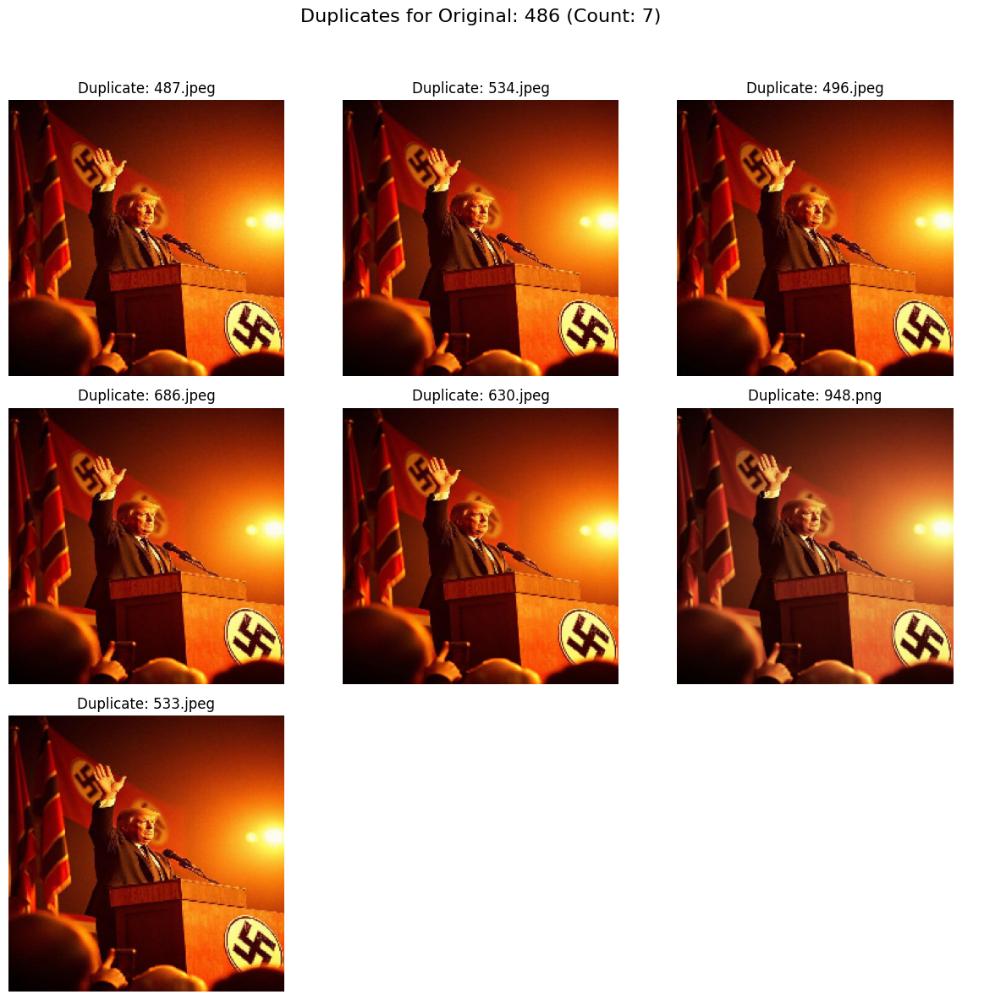

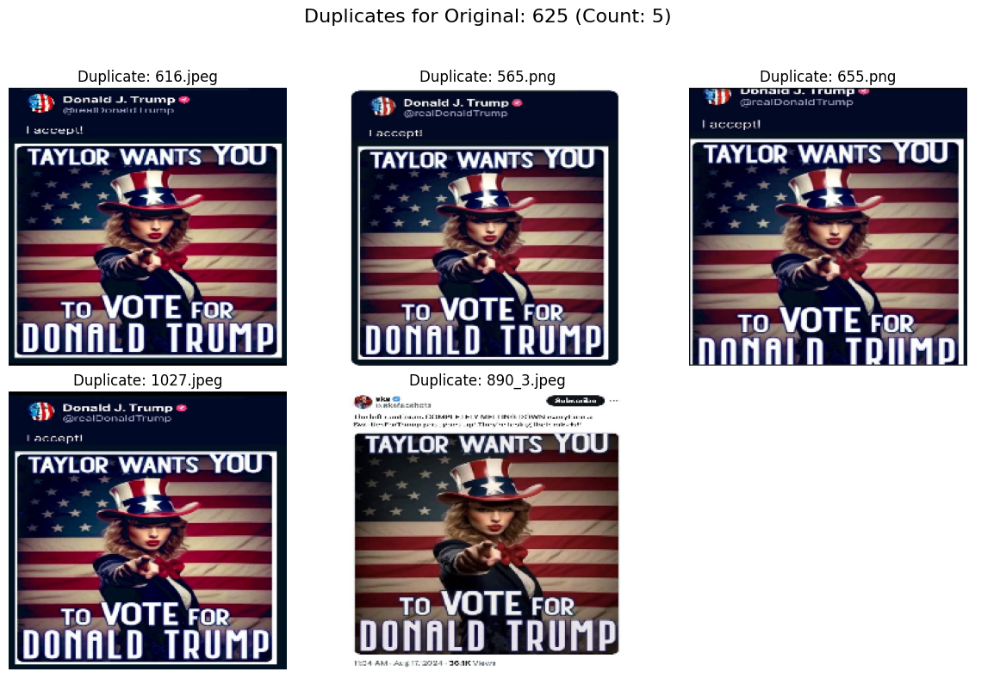

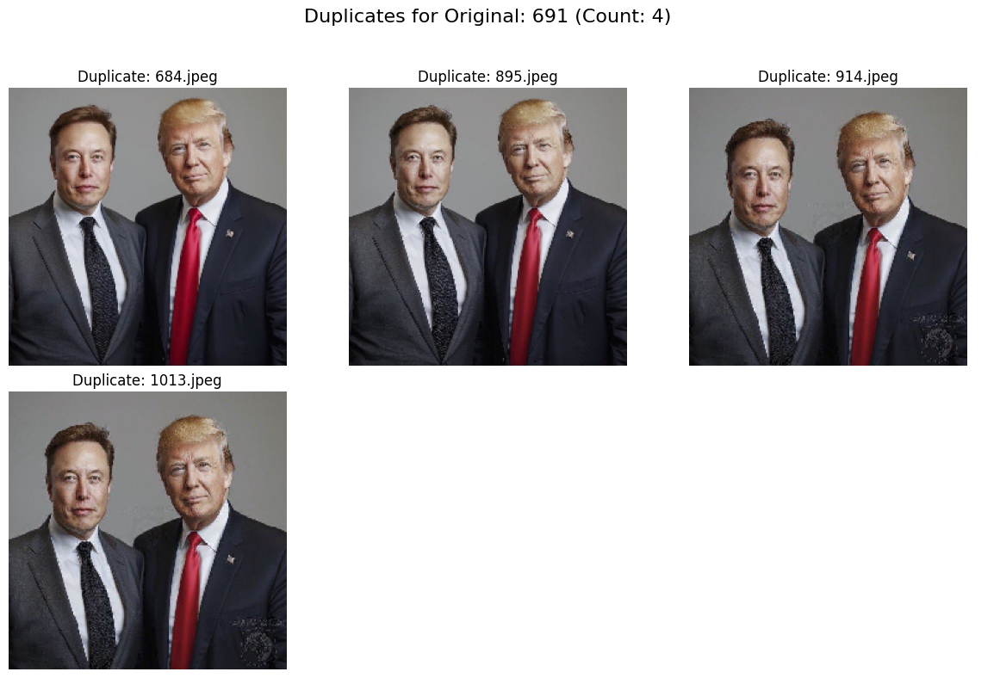

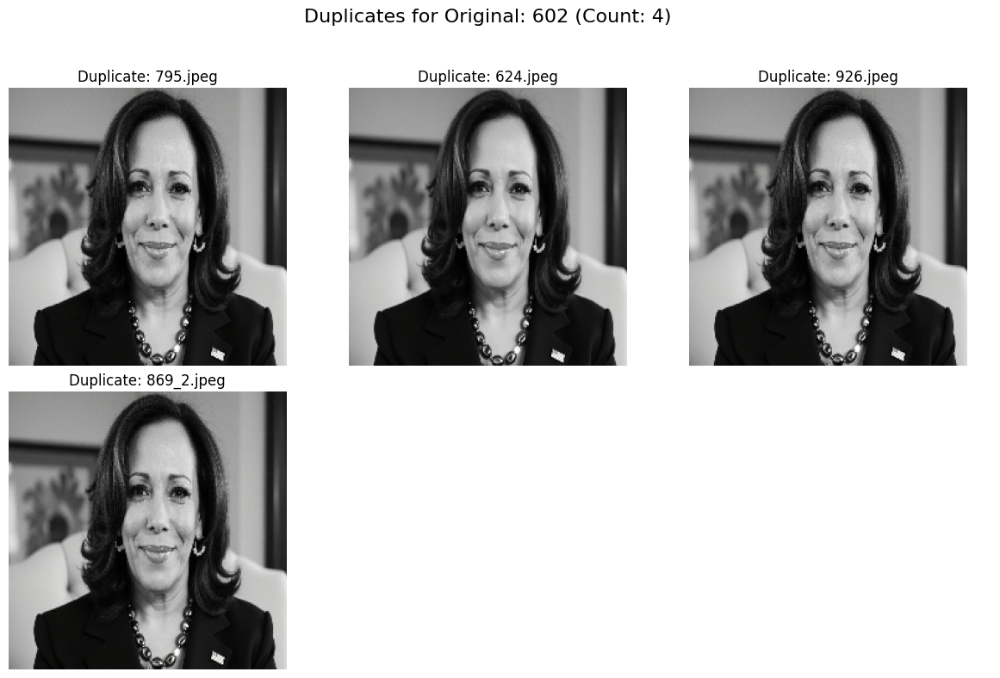

In [10]:
if results:
    top_10 = results_sorted[:10]
    top_5_groups = top_10[:5]

    for r in top_5_groups:
        # Exclude the original; plot only the duplicates
        duplicates_files = r['group_files'][1:]
        if not duplicates_files:
            print(f"No duplicates to plot for original: {r['original_incident']}")
            continue
        num_duplicates = len(duplicates_files)
        num_cols = min(3, num_duplicates)
        num_rows = int(np.ceil(num_duplicates / num_cols))
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols*4, num_rows*4))
        # Ensure axs is a flat array for ease of iteration
        if num_rows == 1 and num_cols == 1:
            axs = np.array([axs])
        elif num_rows == 1:
            axs = np.array(axs).flatten()
        elif num_cols == 1:
            axs = np.array([ax for ax in axs]).flatten()
        else:
            axs = axs.flatten()

        for i, file in enumerate(duplicates_files):
            file_path = os.path.join(images_dir, file)
            try:
                img = image.load_img(file_path, target_size=(224, 224))
                axs[i].imshow(img)
                axs[i].set_title(f"Duplicate: {file}")
                axs[i].axis('off')
            except Exception as e:
                axs[i].text(0.5, 0.5, "Error loading image",
                            horizontalalignment='center', verticalalignment='center')
                axs[i].axis('off')
        # Turn off any unused subplots
        for j in range(i+1, len(axs)):
            axs[j].axis('off')
        fig.suptitle(f"Duplicates for Original: {r['original_incident']} (Count: {r['duplicate_count']})", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
else:
    print("No duplicate groups found for detailed duplicate visualization.")

In [11]:
total_images = len(os.listdir(images_dir))
total_duplicate_images = sum(r['duplicate_count'] for r in results)
remaining_originals = total_images - total_duplicate_images

print("Total images in folder:", total_images)
print("Total duplicate images (to remove):", total_duplicate_images)
print("Total original images remaining:", remaining_originals)

Total images in folder: 641
Total duplicate images (to remove): 245
Total original images remaining: 396


The embedding approach allows us to see the small variants of the most "duplicated" images, with Kamala Harris at a communism rally being the most popular. Variants include one with a "KAMALUNISM" banner at the top and also Kamala Harris being replaced with Donald Trump, likely a counterattack from the opposite party. Other images are seemingly the same, apart from different screenshots of Taylor Swift in support of Donald Trump.

This approach is seemingly more robust, so we will continue with this filtering.

# Identifying/Removing screenshots


In [12]:
duplicate_indices = set()
for group in groups.values():
    if len(group) > 1:
        duplicate_indices.update(group)

# Unique images are those not part of any duplicate group.
unique_indices = set(range(n)) - duplicate_indices
unique_images = [filenames[i] for i in unique_indices]

# Original images from each duplicate group.
original_images = [result['original_file'] for result in results]

# Valid images are the union of unique images and the originals from duplicate groups.
# Use a set union to avoid duplicates if any.
valid_images = list(set(unique_images) | set(original_images))

In [17]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model

from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

base_model = MobileNetV2(weights='imagenet', include_top=False, pooling='avg')
# The output of base_model is now a 1280-d embedding for each image

# Embedding an image
def get_embedding(img_path, target_size=(224, 224)):
    # Load and resize image
    img = image.load_img(img_path, target_size=target_size)
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    # Generate embedding
    embedding = base_model.predict(x, verbose=0)
    return embedding.flatten()

filenames = []
embeddings = []

for fname in tqdm(valid_images, desc="Embedding images"):
    fpath = os.path.join(images_dir, fname)
    if os.path.isfile(fpath):
        try:
            emb = get_embedding(fpath)
            embeddings.append(emb)
            filenames.append(fname)
        except Exception as e:
            print(f"Error processing {fname}: {e}")

embeddings = np.array(embeddings)
print("Total images embedded:", len(embeddings))

# ------------------
# K-Means Clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans_labels = kmeans.fit_predict(embeddings)

print("K-Means clustering complete.")
print(f"Cluster distribution (K-Means):")
for c in range(num_clusters):
    count_c = np.sum(kmeans_labels == c)
    print(f"  Cluster {c}: {count_c} images")

# Evaluate clustering quality with Silhouette Score
sil_score_km = silhouette_score(embeddings, kmeans_labels)
print(f"Silhouette Score (K-Means): {sil_score_km:.3f}")

# ------------------
# DBSCAN - alternative, density-based clustering
dbscan = DBSCAN(eps=10, min_samples=3, metric='euclidean')
dbscan_labels = dbscan.fit_predict(embeddings)

# Assigns -1 to outliers/noise
unique_labels = set(dbscan_labels)
# print("DBSCAN clustering complete.")
# print("Unique clusters (including -1 for noise):", unique_labels)

# counts = {}
# for lbl in dbscan_labels:
#     counts[lbl] = counts.get(lbl, 0) + 1
# for lbl, count_lbl in counts.items():
#     print(f"  Label {lbl}: {count_lbl} images")

# #  For silhouette, filter out outliers first.
# valid_dbscan_mask = dbscan_labels != -1
# if np.sum(valid_dbscan_mask) > 1:
#     sil_score_db = silhouette_score(embeddings[valid_dbscan_mask], dbscan_labels[valid_dbscan_mask])
#     print(f"Silhouette Score (DBSCAN, excluding outliers): {sil_score_db:.3f}")
# else:
#     print("Not enough valid points to compute silhouette score for DBSCAN.")

<ipython-input-17-1388e28a4d68>:11: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False, pooling='avg')
Embedding images: 100%|██████████| 396/396 [00:43<00:00,  9.01it/s]

Total images embedded: 396
K-Means clustering complete.
Cluster distribution (K-Means):
  Cluster 0: 42 images
  Cluster 1: 145 images
  Cluster 2: 17 images
  Cluster 3: 111 images
  Cluster 4: 81 images
Silhouette Score (K-Means): 0.033


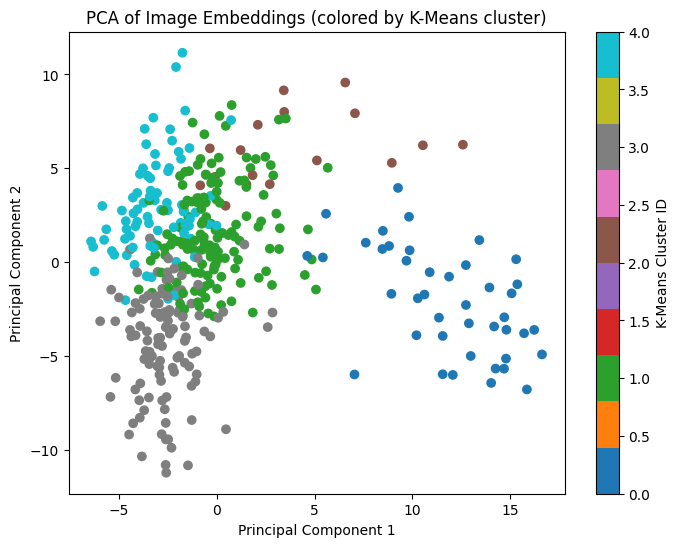

In [18]:
# Visualization via PCA

pca = PCA(n_components=2, random_state=42)
reduced_embeddings = pca.fit_transform(embeddings)

plt.figure(figsize=(8,6))
scatter = plt.scatter(
    reduced_embeddings[:,0],
    reduced_embeddings[:,1],
    c=kmeans_labels,
    cmap='tab10'
)
plt.colorbar(scatter, label="K-Means Cluster ID")
plt.title("PCA of Image Embeddings (colored by K-Means cluster)")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

In [19]:
# Inspect Images from a Specific Cluster
def show_cluster_images(cluster_id, max_images=5):
    indices = [i for i, label in enumerate(kmeans_labels) if label == cluster_id]
    print(f"Displaying up to {max_images} images from cluster {cluster_id}...")

    n_show = min(len(indices), max_images)
    if n_show == 0:
        print("No images in this cluster.")
        return

    fig, axs = plt.subplots(1, n_show, figsize=(5 * n_show, 5))

    for ax, idx in zip(axs, indices[:n_show]):
        img_path = os.path.join(images_dir, filenames[idx])
        pil_img = Image.open(img_path).convert("RGB")
        ax.imshow(pil_img)
        ax.set_title(f"Cluster {cluster_id}\n{filenames[idx]}")
        ax.axis("off")
    plt.tight_layout()
    plt.show()


Displaying up to 10 images from cluster 0...


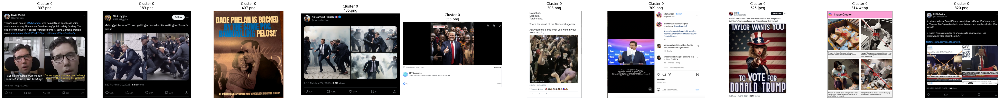

In [20]:
show_cluster_images(cluster_id=0, max_images=10)

Displaying up to 10 images from cluster 1...


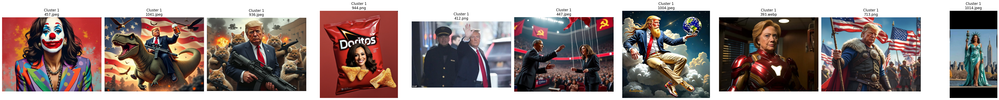

In [21]:
show_cluster_images(cluster_id=1, max_images=10)

Displaying up to 10 images from cluster 2...


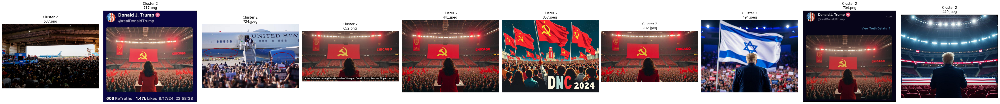

In [22]:
show_cluster_images(cluster_id=2, max_images=10)

Displaying up to 10 images from cluster 3...


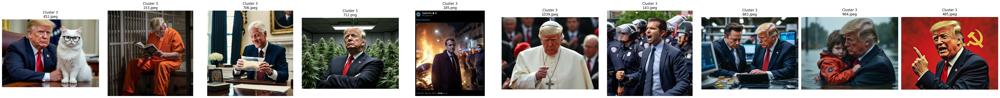

In [23]:
show_cluster_images(cluster_id=3, max_images=10)

Displaying up to 10 images from cluster 4...


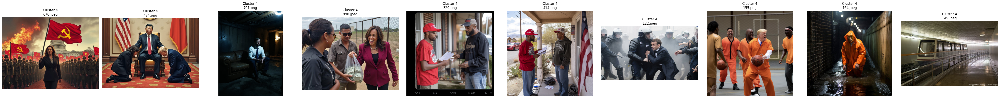

In [24]:
show_cluster_images(cluster_id=4, max_images=10)

We see that the first cluster is mostly comprised of screenshots, which we now filter away into a separate folder (in order to produce the final set of images to conduct analysis with). Some manual tweaks might have to be done.

In [25]:
import shutil

screenshots_dir = "/content/drive/MyDrive/CSM 2025/screenshots"
final_images_dir = "/content/drive/MyDrive/CSM 2025/final_images"

os.makedirs(screenshots_dir, exist_ok=True)
os.makedirs(final_images_dir, exist_ok=True)

for fname, label in zip(filenames, kmeans_labels):
    src = os.path.join(images_dir, fname)
    if label == 0:
        dst = os.path.join(screenshots_dir, fname)
    else:
        dst = os.path.join(final_images_dir, fname)

    try:
        shutil.copy(src, dst)
    except Exception as e:
        print(f"Error copying file {fname}: {e}")

print("Files have been successfully sorted into 'screenshots' and 'final_images'.")

Files have been successfully sorted into 'screenshots' and 'final_images'.
